In [1]:
# Cell 2: Install required packages
!pip install ultralytics
!pip install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 974.5/974.5 kB 42.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 115.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 83.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 53.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 86.0 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

In [2]:
# Cell 3: Import necessary libraries
import os
from ultralytics import YOLO
import yaml
from IPython.display import display, Image
import torch

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
# Cell 4: Set up paths and configuration
# Adjust these paths according to your Drive structure
DATASET_PATH = '/content/drive/MyDrive/Characters_Arabic.v2i.yolov8'  # Update this path
yaml_path = os.path.join(DATASET_PATH, 'data.yaml')

# Load and verify the dataset configuration
with open(yaml_path, 'r') as file:
    data_config = yaml.safe_load(file)

print("Number of classes:", data_config['nc'])
print("Class names:", data_config['names'])

Number of classes: 118
Class names: ['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '3', '4', '5', '6', '7', '8', '9', 'Ar_0', 'Ar_1', 'Ar_2', 'Ar_3', 'Ar_4', 'Ar_5', 'Ar_6', 'Ar_7', 'Ar_8', 'Ar_9', 'Ar_a', 'Ar_b', 'Ar_d', 'Ar_e', 'Ar_g', 'Ar_h', 'Ar_j', 'Ar_k', 'Ar_l', 'Ar_n', 'Ar_r', 'Ar_s', 'Ar_t', 'Ar_u', 'Ar_v', 'Ar_x', 'Ar_z', 'En_0', 'En_1', 'En_2', 'En_3', 'En_4', 'En_5', 'En_6', 'En_7', 'En_8', 'En_9', 'En_a', 'En_b', 'En_d', 'En_e', 'En_g', 'En_h', 'En_j', 'En_k', 'En_l', 'En_n', 'En_r', 'En_s', 'En_t', 'En_u', 'En_v', 'En_x', 'En_z', 'TU', 'aain', 'ain', 'alf', 'b', 'baa', 'd', 'dal', 'ein', 'faa', 'g', 'geem', 'gh', 'h', 'haa', 'kaf', 'l', 'lam', 'libia1', 'libia2', 'libia3', 'm', 'malul', 'meem', 'n', 'non', 'raa', 's', 'sad', 'sen', 't', 'ta', 'taa', 'v', 'waaw', 'y', 'yaa', 'zen']


In [4]:
# Cell 1: Mount Drive and verify data structure
from google.colab import drive
import os

# Cell 1: Check for images in different locations
from pathlib import Path

DATASET_PATH = '/content/drive/MyDrive/Characters_Arabic.v2i.yolov8'

def find_images_recursive(base_path):
    print(f"Searching for images in: {base_path}")
    image_extensions = {'.jpg', '.jpeg', '.png', '.JPG', '.JPEG', '.PNG'}

    # List all files in the base directory and its subdirectories
    for root, dirs, files in os.walk(base_path):
        image_files = [f for f in files if Path(f).suffix in image_extensions]
        if image_files:
            print(f"Found {len(image_files)} images in {root}")
            print(f"Sample image names: {image_files[:5]}")

find_images_recursive(DATASET_PATH)

Searching for images in: /content/drive/MyDrive/Characters_Arabic.v2i.yolov8
Found 288 images in /content/drive/MyDrive/Characters_Arabic.v2i.yolov8/valid/images
Sample image names: ['961416005-20181221_095753-jpg-NR-1_jpg.rf.de6bacd4229bb24621947acbc7929520.jpg', 'r_130_jpg.rf.904967477acebda7d63af98ca3c48ab2.jpg', 'img30_jpg.rf.7c22399c9749e135d09d0a5123831fba.jpg', '961416005-20181221_095857-jpg-NR-1_jpg.rf.7bc303cdfb8e933d6c250db58d436dca.jpg', 'CH_66-Y-25877_0322022-02-27-161251_jpg.rf.a012bc254fc183b30bcbfe0f6842929c.jpg']
Found 3864 images in /content/drive/MyDrive/Characters_Arabic.v2i.yolov8/train/images
Sample image names: ['img51_jpg.rf.eb40b01f8681311754f36b7d0248b478.jpg', 'CH_27-Sad-83511_02402022-02-27-161310_jpg.rf.6cc09d995d3c8fc72ed6f2b41481e675.jpg', '000028_auto_jpg.rf.947ec527a22be6cda270dc34f9fee6df.jpg', 'IMG_3844_jpg.rf.9bcb5f8978a83c063a7f6facfa45df17.jpg', '191_auto_jpg.rf.3562293dc326c2f91da91faa82edbf6d.jpg']
Found 230 images in /content/drive/MyDrive/Charac

In [5]:
# Cell 5: Initialize and train YOLOv8 model
# Choose model size: n(nano), s(small), m(medium), l(large), x(xlarge)
model = YOLO('yolov8s.pt')  # Load pretrained YOLOv8 small model

# Training configuration
results = model.train(
    data=yaml_path,
    epochs=100,  # Number of epochs
    imgsz=416,   # Image size
    batch=16,    # Batch size (adjust based on your GPU memory)
    patience=20, # Early stopping patience
    device=0 if torch.cuda.is_available() else 'cpu',
    project='character_detection',
    name='train1',
    save=True,   # Save best model
    plots=True,  # Generate plots
    verbose=True
)

100%|██████████| 21.5M/21.5M [00:00<00:00, 240MB/s]


Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/drive/MyDrive/Characters_Arabic.v2i.yolov8/data.yaml, epochs=100, time=None, patience=20, batch=16, imgsz=416, save=True, save_period=-1, cache=False, device=0, workers=8, project=character_detection, name=train1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=Tr

100%|██████████| 755k/755k [00:00<00:00, 40.9MB/s]


Overriding model.yaml nc=80 with nc=118

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralyti

100%|██████████| 5.35M/5.35M [00:00<00:00, 152MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/Characters_Arabic.v2i.yolov8/train/labels.cache... 3864 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3864/3864 [00:00<?, ?it/s]

WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 63, len(boxes) = 32415. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/Characters_Arabic.v2i.yolov8/valid/labels.cache... 288 images, 0 backgrounds, 0 corrupt: 100%|██████████| 288/288 [00:00<?, ?it/s]


Plotting labels to character_detection/train1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=8.2e-05, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to character_detection/train1
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100       1.9G      1.774      4.219       1.45        114        416: 100%|██████████| 242/242 [13:18<00:00,  3.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.28it/s]

                   all        288       2329      0.571      0.163       0.11     0.0699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.39G      1.312       2.17      1.186         49        416: 100%|██████████| 242/242 [00:57<00:00,  4.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.30it/s]

                   all        288       2329      0.663       0.42      0.497       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.44G      1.228      1.568      1.157        122        416: 100%|██████████| 242/242 [00:58<00:00,  4.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.67it/s]


                   all        288       2329      0.744      0.628      0.714      0.489

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.46G      1.167      1.255      1.134         92        416: 100%|██████████| 242/242 [00:58<00:00,  4.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.30it/s]

                   all        288       2329      0.791      0.759      0.844      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.46G      1.126        1.1      1.112        111        416: 100%|██████████| 242/242 [00:56<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.33it/s]

                   all        288       2329      0.764       0.84      0.885      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.46G      1.105      1.009      1.103        118        416: 100%|██████████| 242/242 [00:57<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.47it/s]

                   all        288       2329       0.87      0.867      0.918      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.46G      1.077     0.9416      1.091        135        416: 100%|██████████| 242/242 [00:56<00:00,  4.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.20it/s]

                   all        288       2329      0.864      0.895      0.922      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.46G      1.056     0.8902      1.073        133        416: 100%|██████████| 242/242 [00:57<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.30it/s]

                   all        288       2329      0.901       0.88       0.94      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.46G      1.042     0.8565      1.068         53        416: 100%|██████████| 242/242 [00:56<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.29it/s]

                   all        288       2329      0.918      0.878      0.947      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.46G      1.032     0.8387      1.064        104        416: 100%|██████████| 242/242 [00:56<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.41it/s]

                   all        288       2329      0.905      0.906      0.949      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.46G       1.02      0.813       1.06        146        416: 100%|██████████| 242/242 [00:56<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.60it/s]

                   all        288       2329      0.892      0.896      0.952      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.46G      1.007     0.7895       1.05         89        416: 100%|██████████| 242/242 [00:56<00:00,  4.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.32it/s]


                   all        288       2329      0.893      0.921      0.961      0.688

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.47G     0.9944     0.7714      1.045        140        416: 100%|██████████| 242/242 [00:56<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.36it/s]

                   all        288       2329      0.917      0.907      0.968      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       2.5G     0.9927     0.7569      1.045         88        416: 100%|██████████| 242/242 [00:56<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.56it/s]

                   all        288       2329      0.901      0.925      0.966      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100       2.5G      0.983     0.7452      1.039         91        416: 100%|██████████| 242/242 [00:56<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.67it/s]

                   all        288       2329      0.906      0.936      0.968      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100       2.5G     0.9659      0.728      1.033        143        416: 100%|██████████| 242/242 [00:56<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.50it/s]

                   all        288       2329      0.903      0.931      0.968      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.53G     0.9592     0.7141      1.027        101        416: 100%|██████████| 242/242 [00:56<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.49it/s]

                   all        288       2329      0.911      0.938      0.972      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.53G     0.9552     0.7035      1.025         89        416: 100%|██████████| 242/242 [00:56<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.85it/s]

                   all        288       2329      0.897      0.947      0.971      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.53G     0.9476     0.6946      1.019         93        416: 100%|██████████| 242/242 [00:55<00:00,  4.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.01it/s]

                   all        288       2329      0.924      0.952      0.973      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.53G     0.9377     0.6852      1.016         85        416: 100%|██████████| 242/242 [00:56<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.34it/s]

                   all        288       2329       0.92      0.955      0.976      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.57G     0.9322      0.678      1.015        102        416: 100%|██████████| 242/242 [00:56<00:00,  4.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.62it/s]

                   all        288       2329      0.936      0.932      0.976      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.57G     0.9251     0.6708      1.011        103        416: 100%|██████████| 242/242 [00:55<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.37it/s]


                   all        288       2329      0.936      0.939      0.973      0.699

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.58G     0.9168     0.6571      1.007         73        416: 100%|██████████| 242/242 [00:56<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.48it/s]

                   all        288       2329      0.942      0.949      0.978      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.61G     0.9134     0.6539      1.007        104        416: 100%|██████████| 242/242 [00:55<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.54it/s]

                   all        288       2329      0.934      0.947      0.974      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.61G     0.9132     0.6487      1.004         90        416: 100%|██████████| 242/242 [00:56<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.87it/s]

                   all        288       2329      0.923      0.958      0.977      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.61G     0.9043     0.6462      1.002        102        416: 100%|██████████| 242/242 [00:56<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.12it/s]

                   all        288       2329      0.941      0.956      0.978      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.61G     0.8952     0.6367     0.9974        132        416: 100%|██████████| 242/242 [00:56<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.38it/s]

                   all        288       2329      0.925      0.948       0.97      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.61G      0.896     0.6312     0.9983        118        416: 100%|██████████| 242/242 [00:56<00:00,  4.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.62it/s]

                   all        288       2329      0.936      0.964       0.98      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.61G     0.8893     0.6275      0.998        134        416: 100%|██████████| 242/242 [00:56<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.68it/s]

                   all        288       2329      0.938      0.953      0.977      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.61G     0.8803     0.6177     0.9908        100        416: 100%|██████████| 242/242 [00:55<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.44it/s]

                   all        288       2329      0.932      0.955      0.973        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.61G     0.8816     0.6177      0.989        130        416: 100%|██████████| 242/242 [00:55<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.60it/s]

                   all        288       2329      0.942      0.947      0.977      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.61G     0.8729     0.6126     0.9894         84        416: 100%|██████████| 242/242 [00:56<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.78it/s]


                   all        288       2329       0.94      0.949      0.979       0.71

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.61G     0.8776     0.6121      0.989         85        416: 100%|██████████| 242/242 [00:55<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.90it/s]

                   all        288       2329      0.938      0.954      0.977      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      2.61G     0.8612     0.5998     0.9837         96        416: 100%|██████████| 242/242 [00:55<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.47it/s]

                   all        288       2329      0.933      0.958      0.976      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.61G     0.8625     0.5998     0.9835        133        416: 100%|██████████| 242/242 [00:55<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.57it/s]

                   all        288       2329       0.94      0.952      0.982      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.61G     0.8585     0.5967     0.9793        138        416: 100%|██████████| 242/242 [00:56<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.57it/s]

                   all        288       2329      0.932      0.953      0.978      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      2.61G     0.8545     0.5876     0.9799        129        416: 100%|██████████| 242/242 [00:56<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.24it/s]

                   all        288       2329       0.94      0.963      0.978      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      2.61G     0.8452     0.5819     0.9767         78        416: 100%|██████████| 242/242 [00:56<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.66it/s]

                   all        288       2329      0.953      0.947      0.979      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.61G      0.841     0.5809      0.975         84        416: 100%|██████████| 242/242 [00:55<00:00,  4.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.69it/s]

                   all        288       2329      0.944      0.945      0.975       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      2.61G      0.842     0.5801     0.9715        125        416: 100%|██████████| 242/242 [00:55<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.50it/s]

                   all        288       2329      0.941       0.95      0.975      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.61G     0.8347     0.5711     0.9737         65        416: 100%|██████████| 242/242 [00:55<00:00,  4.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.27it/s]

                   all        288       2329      0.922      0.971      0.979      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      2.61G     0.8317     0.5686     0.9686        131        416: 100%|██████████| 242/242 [00:56<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:02<00:00,  3.50it/s]

                   all        288       2329      0.937      0.947      0.975      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.61G     0.8266     0.5652     0.9648         66        416: 100%|██████████| 242/242 [00:56<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.78it/s]


                   all        288       2329      0.925       0.96      0.976      0.704
EarlyStopping: Training stopped early as no improvement observed in last 20 epochs. Best results observed at epoch 23, best model saved as best.pt.
To update EarlyStopping(patience=20) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.

43 epochs completed in 0.925 hours.
Optimizer stripped from character_detection/train1/weights/last.pt, 22.6MB
Optimizer stripped from character_detection/train1/weights/best.pt, 22.6MB

Validating character_detection/train1/weights/best.pt...
Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,171,250 parameters, 0 gradients, 28.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.17it/s]


                   all        288       2329      0.942      0.948      0.978      0.714
                     0         41         45      0.906      0.853      0.934      0.481
                     1        141        192      0.995      0.959      0.994        0.6
                    10          1          1      0.873          1      0.995      0.796
                    11          7          7      0.947          1      0.995      0.826
                    12          9          9      0.959          1      0.995      0.822
                    13          8          8          1      0.981      0.995      0.817
                    14          4          4      0.599          1      0.995      0.895
                    15          6          6          1      0.602      0.894      0.783
                    16          2          2      0.864          1      0.995      0.895
                    17          2          2      0.817          1      0.995      0.895
                    1

In [6]:
# Cell 6: Plot training results
!ls /content/character_detection/train1  # Check training outputs

args.yaml					   results.png
confusion_matrix_normalized.png			   train_batch0.jpg
confusion_matrix.png				   train_batch1.jpg
events.out.tfevents.1744489724.85fa3e76865b.575.0  train_batch2.jpg
F1_curve.png					   val_batch0_labels.jpg
labels_correlogram.jpg				   val_batch0_pred.jpg
labels.jpg					   val_batch1_labels.jpg
P_curve.png					   val_batch1_pred.jpg
PR_curve.png					   val_batch2_labels.jpg
R_curve.png					   val_batch2_pred.jpg
results.csv					   weights


In [7]:
# Cell 7: Validate the model
model = YOLO('/content/character_detection/train1/weights/best.pt')
metrics = model.val()
print(metrics)

Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,171,250 parameters, 0 gradients, 28.7 GFLOPs


val: Scanning /content/drive/MyDrive/Characters_Arabic.v2i.yolov8/valid/labels.cache... 288 images, 0 backgrounds, 0 corrupt: 100%|██████████| 288/288 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.16it/s]


                   all        288       2329      0.942      0.949      0.978      0.712
                     0         41         45      0.906      0.853      0.935      0.486
                     1        141        192      0.995      0.959      0.994        0.6
                    10          1          1       0.87          1      0.995      0.796
                    11          7          7      0.946          1      0.995      0.826
                    12          9          9      0.959          1      0.995      0.822
                    13          8          8          1      0.983      0.995      0.816
                    14          4          4      0.598          1      0.995      0.895
                    15          6          6          1      0.607      0.894      0.783
                    16          2          2      0.863          1      0.995      0.895
                    17          2          2      0.817          1      0.995      0.895
                    1


Processing: 109_jpg.rf.7d96426552cf69303a51b04398544c40.jpg

image 1/1 /content/drive/MyDrive/Characters_Arabic.v2i.yolov8/test/images/109_jpg.rf.7d96426552cf69303a51b04398544c40.jpg: 416x416 1 1, 1 2, 1 4, 1 alf, 1 faa, 1 lam, 10.3ms
Speed: 1.2ms preprocess, 10.3ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)

Detections:
Detection 1: Class: alf, Confidence: 0.94
Detection 2: Class: faa, Confidence: 0.93
Detection 3: Class: lam, Confidence: 0.92
Detection 4: Class: 2, Confidence: 0.89
Detection 5: Class: 4, Confidence: 0.84
Detection 6: Class: 1, Confidence: 0.77


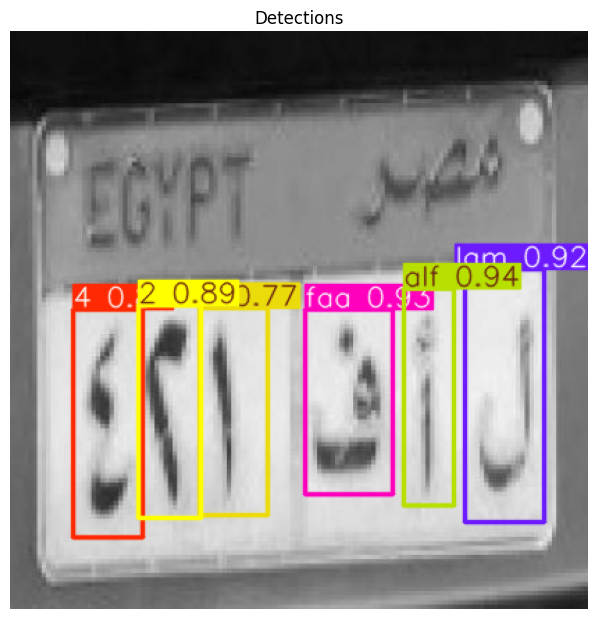


Processing: r_47_jpg.rf.ad0a80bda28443750bf768b6b9d016d3.jpg

image 1/1 /content/drive/MyDrive/Characters_Arabic.v2i.yolov8/test/images/r_47_jpg.rf.ad0a80bda28443750bf768b6b9d016d3.jpg: 416x416 1 2, 1 4, 1 5, 1 7, 1 meem, 1 sad, 1 sen, 10.4ms
Speed: 1.3ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)

Detections:
Detection 1: Class: meem, Confidence: 0.93
Detection 2: Class: sen, Confidence: 0.92
Detection 3: Class: sad, Confidence: 0.91
Detection 4: Class: 2, Confidence: 0.89
Detection 5: Class: 7, Confidence: 0.86
Detection 6: Class: 5, Confidence: 0.84
Detection 7: Class: 4, Confidence: 0.79


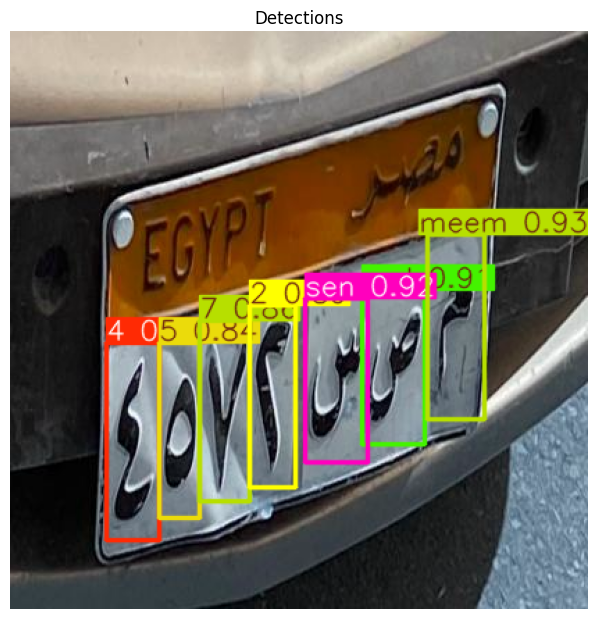


Processing: IMG_4328_jpg.rf.a75ce98acc4323d7c26281ebc14156d7.jpg

image 1/1 /content/drive/MyDrive/Characters_Arabic.v2i.yolov8/test/images/IMG_4328_jpg.rf.a75ce98acc4323d7c26281ebc14156d7.jpg: 416x416 1 Ar_1, 2 Ar_2s, 1 Ar_9, 1 Ar_d, 1 Ar_h, 1 Ar_x, 1 En_1, 2 En_2s, 1 En_9, 1 En_d, 1 En_h, 1 En_x, 10.6ms
Speed: 1.4ms preprocess, 10.6ms inference, 142.9ms postprocess per image at shape (1, 3, 416, 416)

Detections:
Detection 1: Class: Ar_d, Confidence: 0.98
Detection 2: Class: En_d, Confidence: 0.97
Detection 3: Class: En_2, Confidence: 0.94
Detection 4: Class: Ar_h, Confidence: 0.94
Detection 5: Class: En_1, Confidence: 0.94
Detection 6: Class: Ar_9, Confidence: 0.93
Detection 7: Class: Ar_x, Confidence: 0.93
Detection 8: Class: En_9, Confidence: 0.93
Detection 9: Class: En_2, Confidence: 0.90
Detection 10: Class: Ar_2, Confidence: 0.88
Detection 11: Class: En_x, Confidence: 0.86
Detection 12: Class: Ar_1, Confidence: 0.84
Detection 13: Class: Ar_2, Confidence: 0.83
Detection 14: Cla

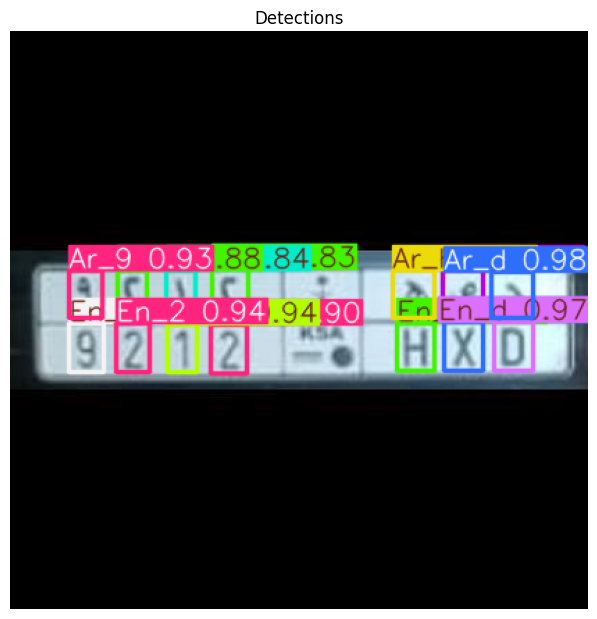

In [8]:
# Cell 8: Test inference with proper imports and visualization
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import cv2

def visualize_detection(model, image_path):
    # Read image
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Run inference
    results = model.predict(image_path, conf=0.25)

    # Plot results
    plt.figure(figsize=(12, 8))

    # Original image with detections
    plt.subplot(1, 2, 1)
    result_img = results[0].plot()
    plt.imshow(result_img)
    plt.title('Detections')
    plt.axis('off')

    # Print detection information
    detections = results[0].boxes
    print("\nDetections:")
    for i, box in enumerate(detections):
        class_id = int(box.cls)
        conf = float(box.conf)
        class_name = model.names[class_id]
        print(f"Detection {i+1}: Class: {class_name}, Confidence: {conf:.2f}")

    plt.tight_layout()
    plt.show()

# Test on images
test_images_path = os.path.join(DATASET_PATH, 'test/images')
test_images = os.listdir(test_images_path)[:3]  # Test first 3 images

for img in test_images:
    print(f"\nProcessing: {img}")
    img_path = os.path.join(test_images_path, img)
    visualize_detection(model, img_path)


Processing: 5.jpg

image 1/1 /content/drive/MyDrive/testing_cars/license_plates_recognition_train/license_plates_recognition_train/5.jpg: 128x416 1 0, 3 1s, 2 4s, 1 7, 1 TU, 45.2ms
Speed: 0.8ms preprocess, 45.2ms inference, 1.3ms postprocess per image at shape (1, 3, 128, 416)

Detections:
Detection 1: Class: 1, Confidence: 0.94
Detection 2: Class: 1, Confidence: 0.92
Detection 3: Class: 0, Confidence: 0.91
Detection 4: Class: 1, Confidence: 0.89
Detection 5: Class: 4, Confidence: 0.89
Detection 6: Class: TU, Confidence: 0.88
Detection 7: Class: 7, Confidence: 0.87
Detection 8: Class: 4, Confidence: 0.73


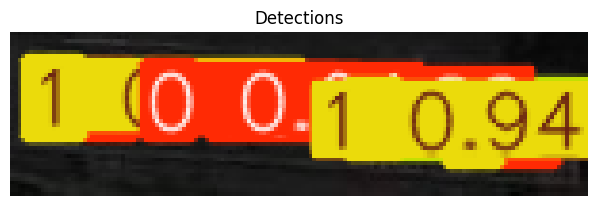


Processing: 293.jpg

image 1/1 /content/drive/MyDrive/testing_cars/license_plates_recognition_train/license_plates_recognition_train/293.jpg: 128x416 2 1s, 1 2, 1 3, 1 7, 1 8, 1 9, 1 TU, 7.9ms
Speed: 0.9ms preprocess, 7.9ms inference, 1.4ms postprocess per image at shape (1, 3, 128, 416)

Detections:
Detection 1: Class: 9, Confidence: 0.97
Detection 2: Class: 3, Confidence: 0.97
Detection 3: Class: 2, Confidence: 0.94
Detection 4: Class: 7, Confidence: 0.91
Detection 5: Class: TU, Confidence: 0.91
Detection 6: Class: 1, Confidence: 0.89
Detection 7: Class: 8, Confidence: 0.89
Detection 8: Class: 1, Confidence: 0.85


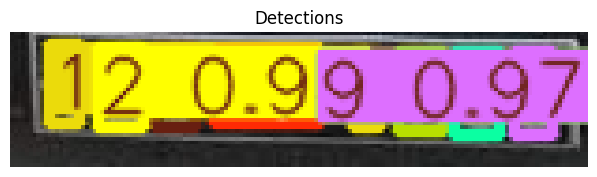


Processing: 400.jpg

image 1/1 /content/drive/MyDrive/testing_cars/license_plates_recognition_train/license_plates_recognition_train/400.jpg: 192x416 1 0, 1 1, 2 2s, 1 3, 1 9, 1 TU, 39.6ms
Speed: 0.9ms preprocess, 39.6ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 416)

Detections:
Detection 1: Class: 0, Confidence: 0.96
Detection 2: Class: 2, Confidence: 0.95
Detection 3: Class: 9, Confidence: 0.92
Detection 4: Class: TU, Confidence: 0.91
Detection 5: Class: 2, Confidence: 0.91
Detection 6: Class: 3, Confidence: 0.90
Detection 7: Class: 1, Confidence: 0.90


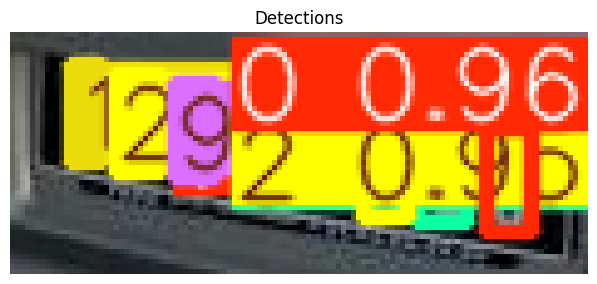

In [9]:
# Cell 8: Test inference with proper imports and visualization
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import cv2

def visualize_detection(model, image_path):
    # Read image
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Run inference
    results = model.predict(image_path, conf=0.25)

    # Plot results
    plt.figure(figsize=(12, 8))

    # Original image with detections
    plt.subplot(1, 2, 1)
    result_img = results[0].plot()
    plt.imshow(result_img)
    plt.title('Detections')
    plt.axis('off')

    # Print detection information
    detections = results[0].boxes
    print("\nDetections:")
    for i, box in enumerate(detections):
        class_id = int(box.cls)
        conf = float(box.conf)
        class_name = model.names[class_id]
        print(f"Detection {i+1}: Class: {class_name}, Confidence: {conf:.2f}")

    plt.tight_layout()
    plt.show()

# Test on images
test_images_path = "/content/drive/MyDrive/testing_cars/license_plates_recognition_train/license_plates_recognition_train"
test_images = os.listdir(test_images_path)[:3]  # Test first 3 images

for img in test_images:
    print(f"\nProcessing: {img}")
    img_path = os.path.join(test_images_path, img)
    visualize_detection(model, img_path)


Processing: 1091.jpg

0: 384x640 1 license_plate, 10.0ms
Speed: 2.2ms preprocess, 10.0ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 192x416 2 0s, 1 1, 1 2, 2 4s, 1 9, 1 TU, 8.4ms
Speed: 0.7ms preprocess, 8.4ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 416)
Detected License Plates:
- 140TU9240 (Confidence: 0.91)


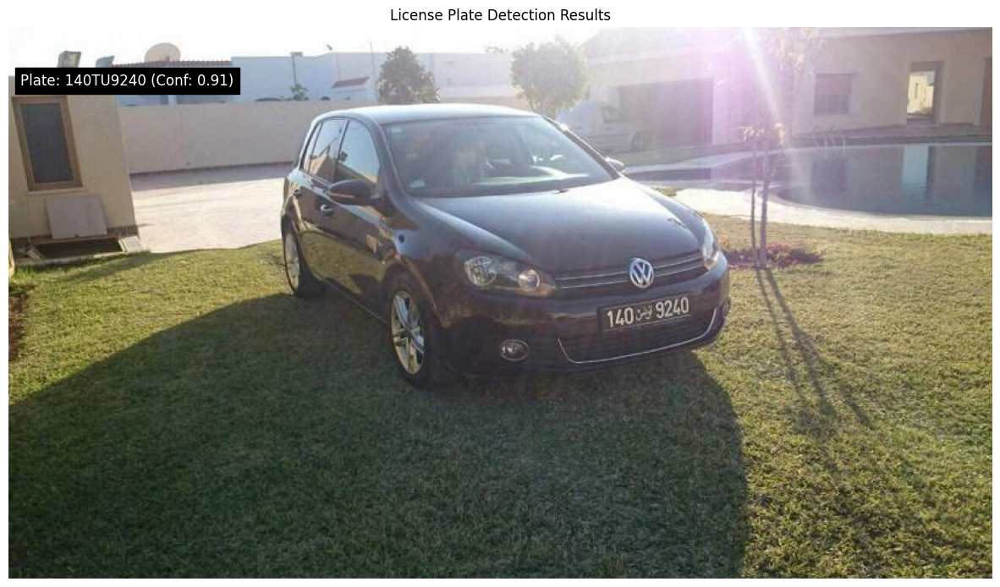


Processing: 938.jpg

0: 640x576 1 license_plate, 10.1ms
Speed: 3.9ms preprocess, 10.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 576)

0: 128x416 1 0, 1 1, 1 3, 2 5s, 1 6, 1 9, 1 TU, 11.0ms
Speed: 0.7ms preprocess, 11.0ms inference, 1.5ms postprocess per image at shape (1, 3, 128, 416)
Detected License Plates:
- 135TU5906 (Confidence: 0.93)


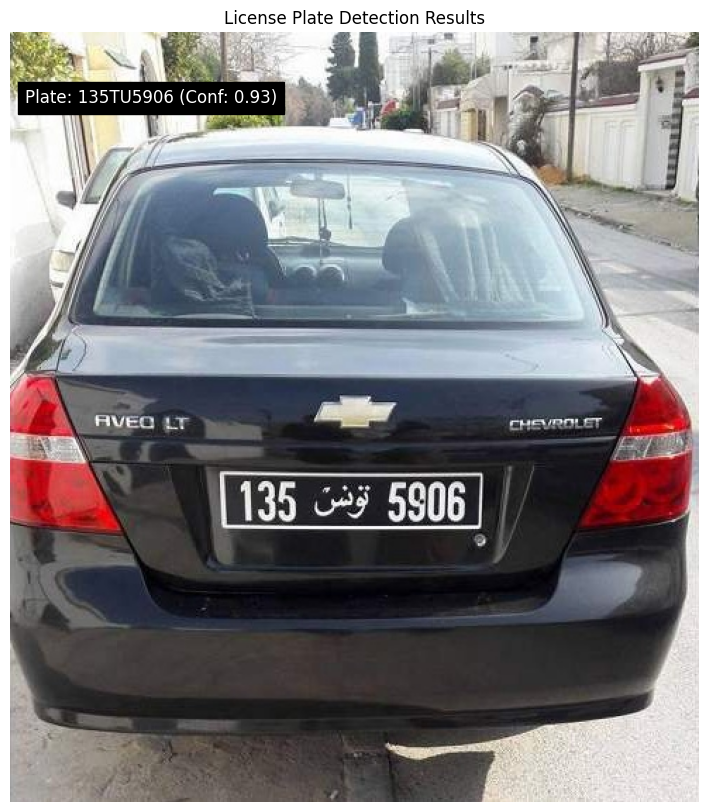


Processing: 1110.jpg

0: 640x480 1 license_plate, 12.1ms
Speed: 3.3ms preprocess, 12.1ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 480)

0: 96x416 1 0, 2 1s, 1 3, 1 5, 1 6, 1 8, 1 9, 1 TU, 14.5ms
Speed: 0.7ms preprocess, 14.5ms inference, 1.4ms postprocess per image at shape (1, 3, 96, 416)
Detected License Plates:
- 181TU36590 (Confidence: 0.83)


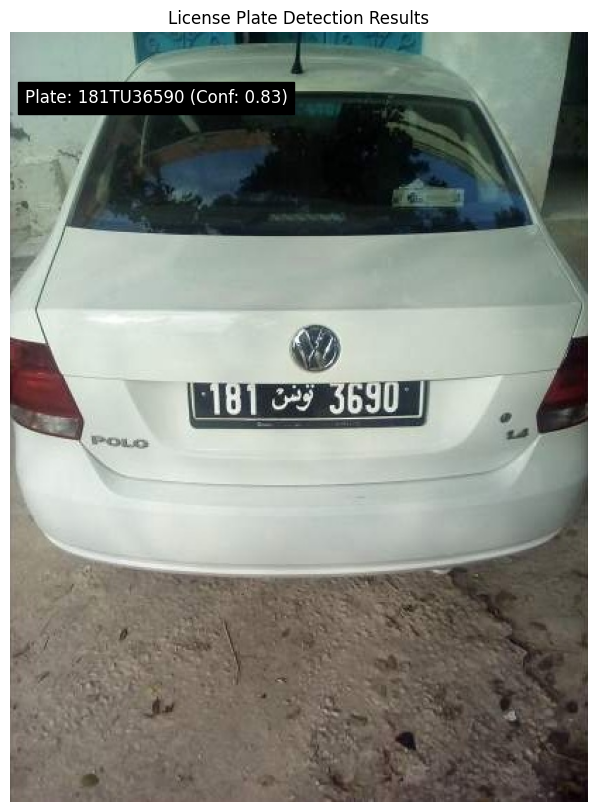


Processing: 981.jpg

0: 448x640 1 license_plate, 14.0ms
Speed: 3.4ms preprocess, 14.0ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)

0: 96x416 1 2, 2 3s, 1 5, 1 7, 1 8, 1 TU, 8.5ms
Speed: 0.7ms preprocess, 8.5ms inference, 1.5ms postprocess per image at shape (1, 3, 96, 416)
Detected License Plates:
- 53TU8723 (Confidence: 0.92)


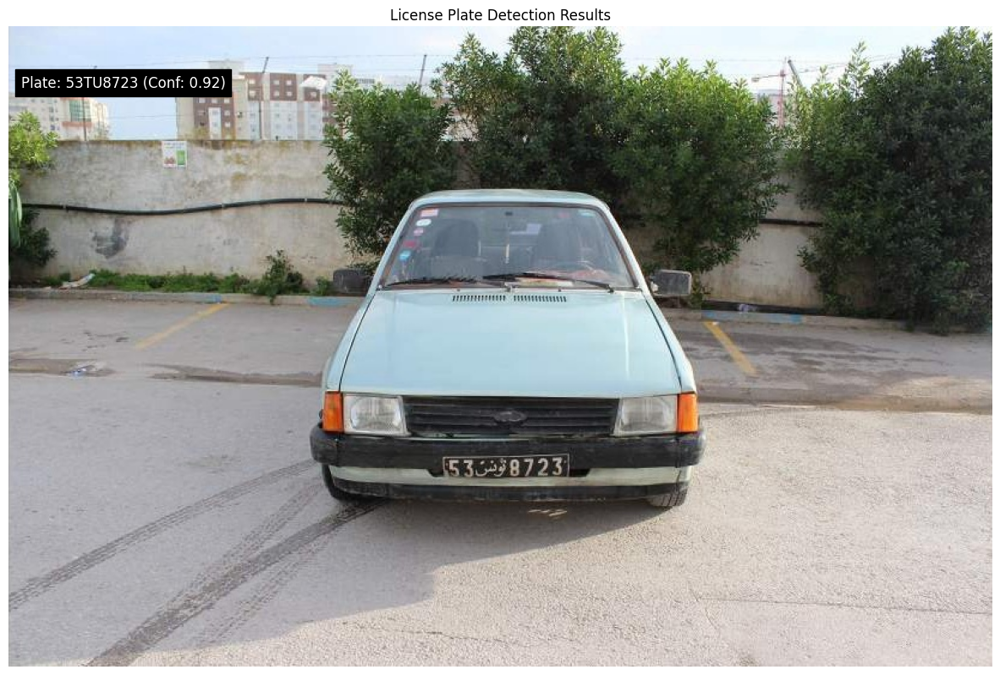


Processing: 1076.jpg

0: 640x480 1 license_plate, 18.9ms
Speed: 3.4ms preprocess, 18.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)

0: 128x416 3 1s, 1 5, 2 6s, 1 8, 1 TU, 14.8ms
Speed: 0.8ms preprocess, 14.8ms inference, 6.4ms postprocess per image at shape (1, 3, 128, 416)
Detected License Plates:
- 151TU1866 (Confidence: 0.91)


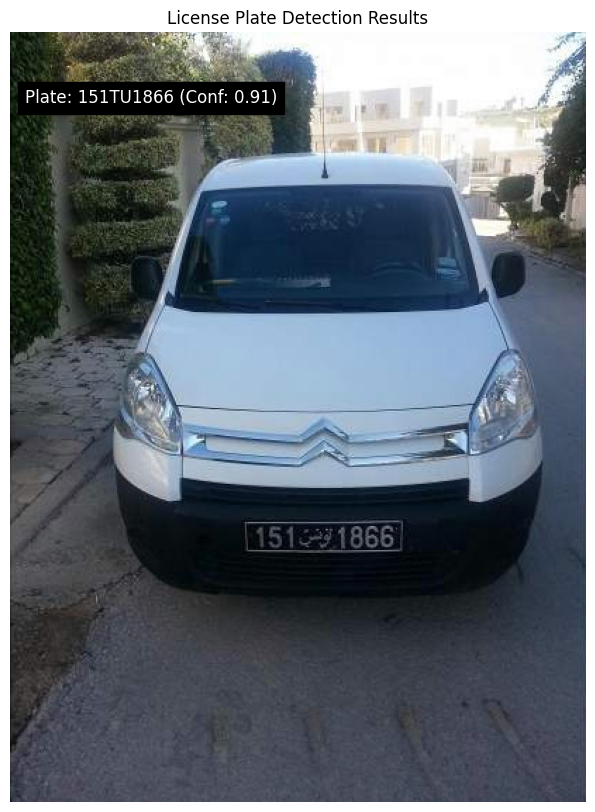

In [13]:
# Updated code with GPU handling
import os
import cv2
import numpy as np
from ultralytics import YOLO
import matplotlib.pyplot as plt
import torch

# Load both models
PLATE_DETECTOR_PATH = '/content/tunisian_lp_detector.pt'  # Update this
CHAR_DETECTOR_PATH = '/content/character_detection/train1/weights/best.pt'

plate_detector = YOLO(PLATE_DETECTOR_PATH)
char_detector = YOLO(CHAR_DETECTOR_PATH)

def sort_boxes_left_to_right(boxes, texts, scores):
    """Sort detected characters from left to right"""
    if len(boxes) == 0:
        return [], []

    char_positions = []
    for box, text, score in zip(boxes, texts, scores):
        x_center = (box[0] + box[2]) / 2
        y_center = (box[1] + box[3]) / 2
        char_positions.append([x_center, y_center, text, score])

    char_positions.sort(key=lambda x: x[0])
    return [char[2] for char in char_positions], [char[3] for char in char_positions]

def process_image(image_path, plate_conf=0.5, char_conf=0.25):
    """Process a single image and return detected license plate numbers"""
    img = cv2.imread(image_path)
    if img is None:
        return "Error: Could not read image"

    # Detect license plates
    plate_results = plate_detector(img, conf=plate_conf)[0]

    all_plates = []

    # Process each detected license plate
    for plate_box in plate_results.boxes.data:
        # Move tensor to CPU and convert to numpy
        if plate_box.is_cuda:
            plate_box = plate_box.cpu()
        plate_box = plate_box.numpy()

        x1, y1, x2, y2, conf, _ = plate_box
        if conf < plate_conf:
            continue

        # Crop license plate
        plate_img = img[int(y1):int(y2), int(x1):int(x2)]

        # Detect characters in the plate
        char_results = char_detector(plate_img, conf=char_conf)[0]

        # Extract character detections
        boxes = []
        texts = []
        scores = []

        for char_box in char_results.boxes.data:
            # Move tensor to CPU and convert to numpy
            if char_box.is_cuda:
                char_box = char_box.cpu()
            char_box = char_box.numpy()

            x1, y1, x2, y2, conf, cls = char_box
            if conf < char_conf:
                continue
            boxes.append([x1, y1, x2, y2])
            texts.append(char_detector.names[int(cls)])
            scores.append(conf)

        # Sort characters left to right
        sorted_texts, sorted_scores = sort_boxes_left_to_right(boxes, texts, scores)

        # Combine characters into plate number
        plate_number = ''.join(sorted_texts)
        avg_confidence = np.mean(sorted_scores) if sorted_scores else 0

        all_plates.append((plate_number, avg_confidence))

    return all_plates

def visualize_results(image_path, results):
    """Visualize the detection results"""
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(15, 10))
    plt.imshow(img)

    # Add text with results
    y_pos = 50
    for plate_number, confidence in results:
        plt.text(10, y_pos, f"Plate: {plate_number} (Conf: {confidence:.2f})",
                color='white', backgroundcolor='black', fontsize=12)
        y_pos += 30

    plt.title("License Plate Detection Results")
    plt.axis('off')
    plt.show()

def process_directory(test_dir, max_images=5):
    """Process all images in a directory"""
    image_extensions = {'.jpg', '.jpeg', '.png', '.bmp'}

    image_files = [f for f in os.listdir(test_dir)
                  if os.path.splitext(f.lower())[1] in image_extensions]

    for img_file in image_files[:max_images]:
        img_path = os.path.join(test_dir, img_file)
        print(f"\nProcessing: {img_file}")

        try:
            results = process_image(img_path)

            print("Detected License Plates:")
            for plate_number, confidence in results:
                print(f"- {plate_number} (Confidence: {confidence:.2f})")

            visualize_results(img_path, results)

        except Exception as e:
            print(f"Error processing {img_file}: {str(e)}")

# Test the pipeline
TEST_DIR = '/content/drive/MyDrive/testing_cars/test/test_private'
process_directory(TEST_DIR)

Found 216 images. Processing up to 20...

Processing image 1/20: 1091.jpg

0: 384x640 1 license_plate, 11.8ms
Speed: 4.0ms preprocess, 11.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 192x416 2 0s, 1 1, 1 2, 2 4s, 1 9, 1 TU, 10.4ms
Speed: 2.1ms preprocess, 10.4ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 416)
Found 1 license plates:
- 140TU9240 (Confidence: 0.91)
Processing time: 0.05 seconds


<ipython-input-14-0b3cc763b19f>:104: UserWarning: tight_layout not applied: number of columns in subplot specifications must be multiples of one another.
  plt.tight_layout()


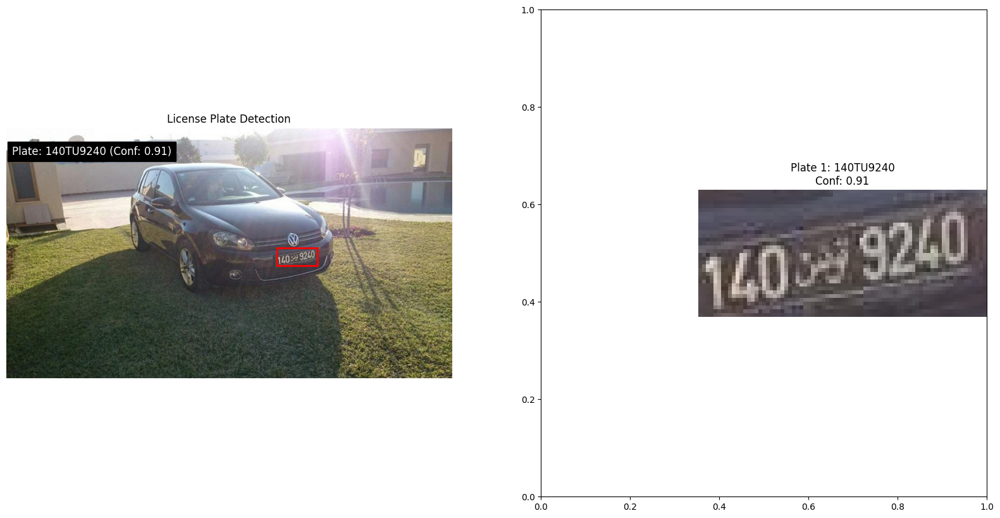


Processing image 2/20: 938.jpg

0: 640x576 1 license_plate, 10.3ms
Speed: 4.8ms preprocess, 10.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 576)

0: 128x416 1 0, 1 1, 1 3, 2 5s, 1 6, 1 9, 1 TU, 11.5ms
Speed: 0.7ms preprocess, 11.5ms inference, 1.5ms postprocess per image at shape (1, 3, 128, 416)
Found 1 license plates:
- 135TU5906 (Confidence: 0.93)
Processing time: 0.05 seconds


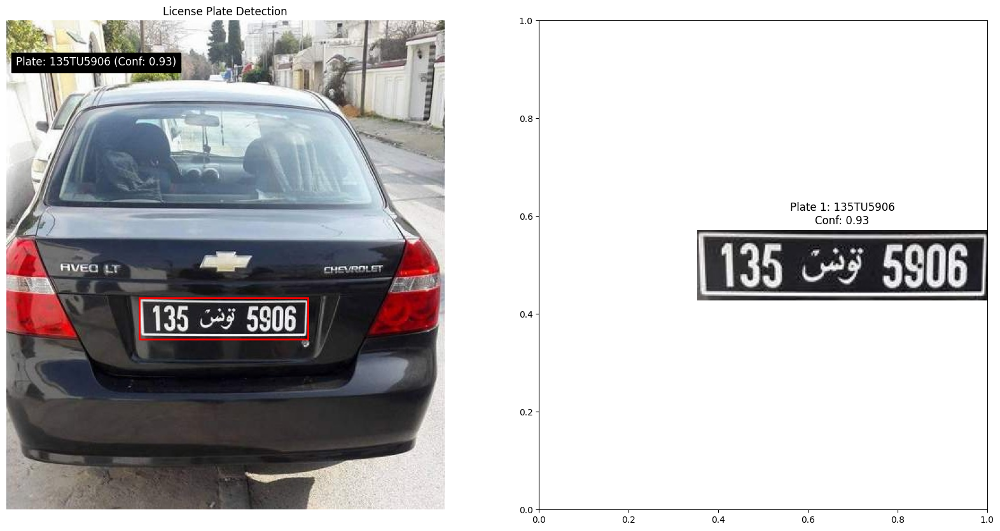


Processing image 3/20: 1110.jpg

0: 640x480 1 license_plate, 15.8ms
Speed: 13.0ms preprocess, 15.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)

0: 96x416 1 0, 2 1s, 1 3, 1 5, 1 6, 1 8, 1 9, 1 TU, 15.5ms
Speed: 0.6ms preprocess, 15.5ms inference, 1.3ms postprocess per image at shape (1, 3, 96, 416)
Found 1 license plates:
- 181TU36590 (Confidence: 0.83)
Processing time: 0.08 seconds


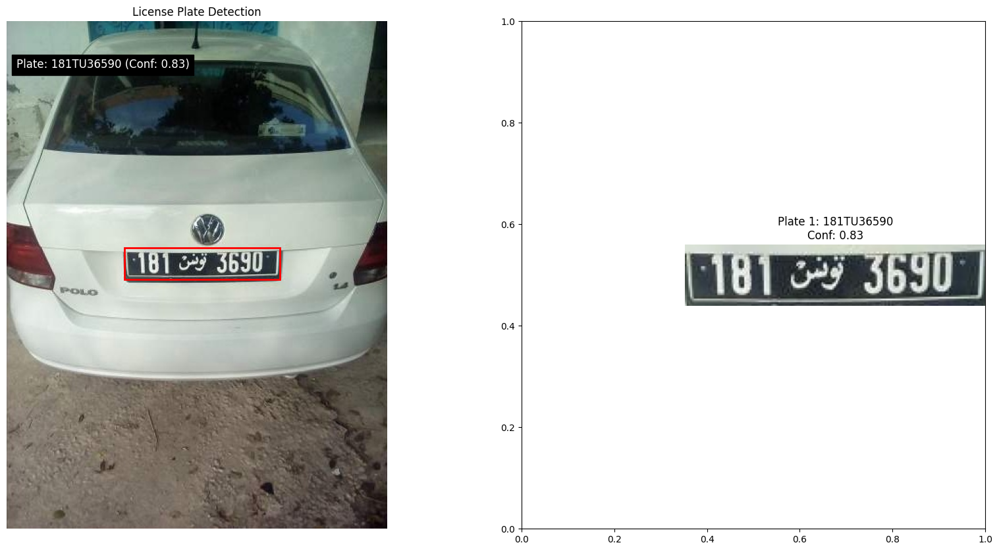


Processing image 4/20: 981.jpg

0: 448x640 1 license_plate, 11.3ms
Speed: 3.3ms preprocess, 11.3ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)

0: 96x416 1 2, 2 3s, 1 5, 1 7, 1 8, 1 TU, 9.5ms
Speed: 0.6ms preprocess, 9.5ms inference, 1.4ms postprocess per image at shape (1, 3, 96, 416)
Found 1 license plates:
- 53TU8723 (Confidence: 0.92)
Processing time: 0.05 seconds


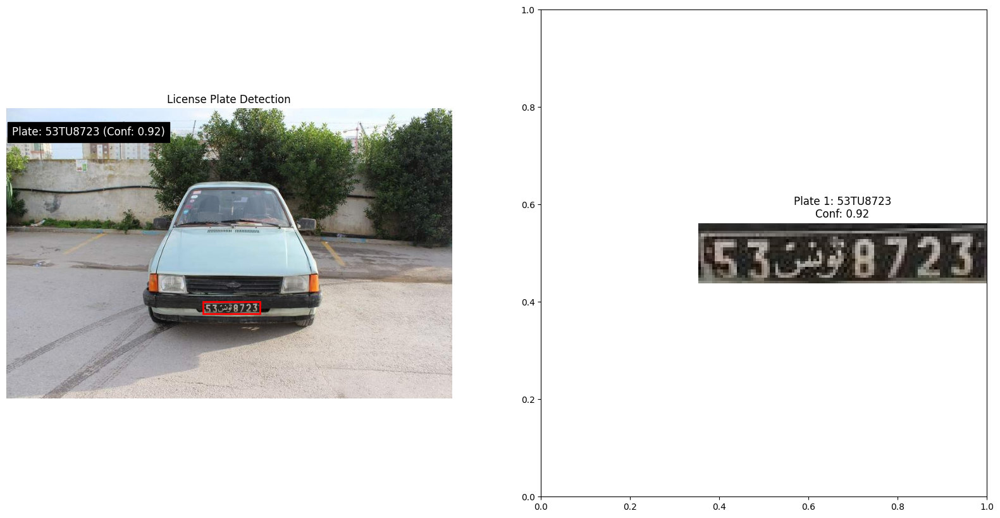


Processing image 5/20: 1076.jpg

0: 640x480 1 license_plate, 10.0ms
Speed: 3.2ms preprocess, 10.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)

0: 128x416 3 1s, 1 5, 2 6s, 1 8, 1 TU, 13.3ms
Speed: 0.7ms preprocess, 13.3ms inference, 1.5ms postprocess per image at shape (1, 3, 128, 416)
Found 1 license plates:
- 151TU1866 (Confidence: 0.91)
Processing time: 0.07 seconds


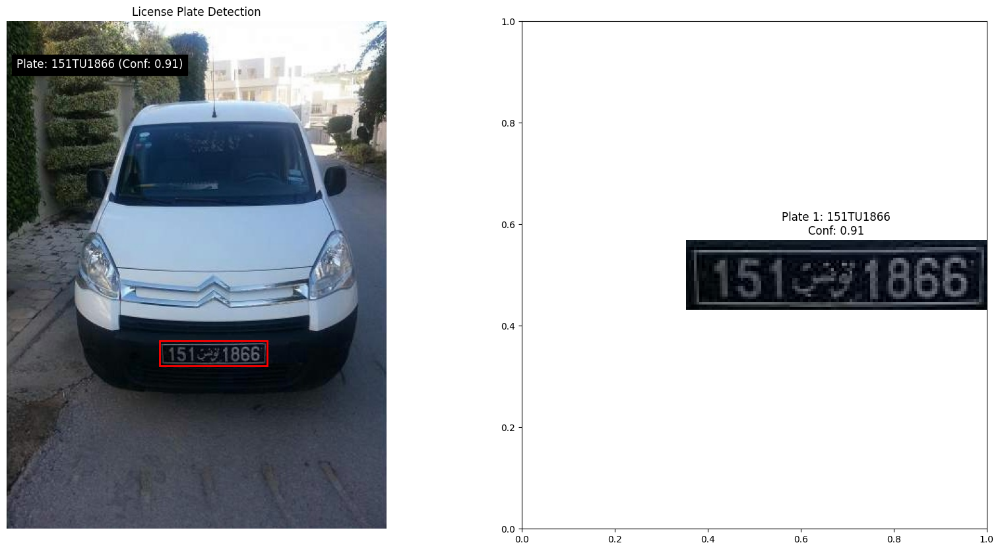


Processing image 6/20: 1090.jpg

0: 640x480 1 license_plate, 9.0ms
Speed: 4.4ms preprocess, 9.0ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 480)

0: 128x416 1 0, 2 1s, 1 3, 1 7, 1 8, 1 TU, 10.4ms
Speed: 0.7ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 128, 416)
Found 1 license plates:
- 131TU870 (Confidence: 0.91)
Processing time: 0.05 seconds


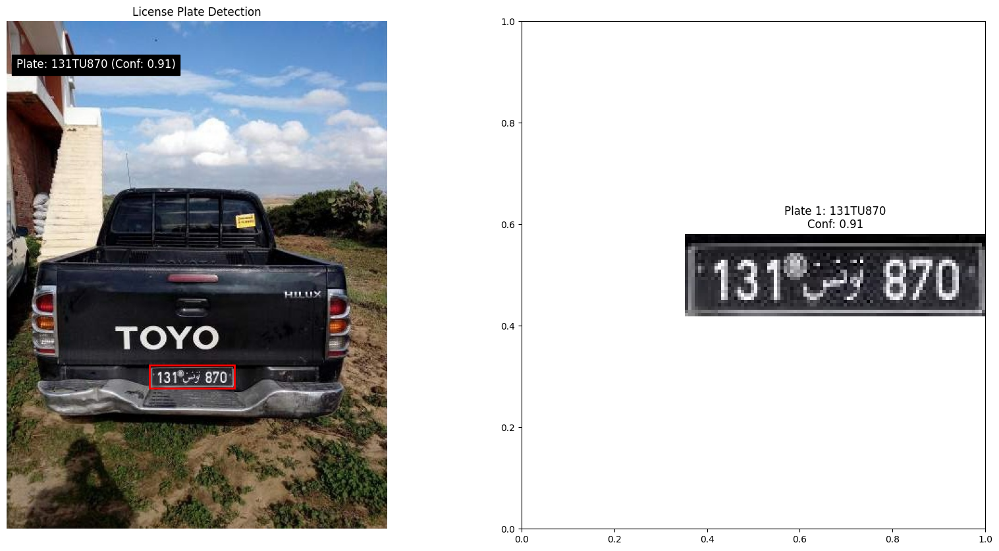


Processing image 7/20: 913.jpg

0: 480x640 1 license_plate, 51.7ms
Speed: 3.8ms preprocess, 51.7ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)

0: 128x416 1 0, 1 3, 1 5, 1 7, 2 8s, 1 TU, 13.0ms
Speed: 0.8ms preprocess, 13.0ms inference, 1.5ms postprocess per image at shape (1, 3, 128, 416)
Found 1 license plates:
- 80TU7538 (Confidence: 0.93)
Processing time: 0.09 seconds


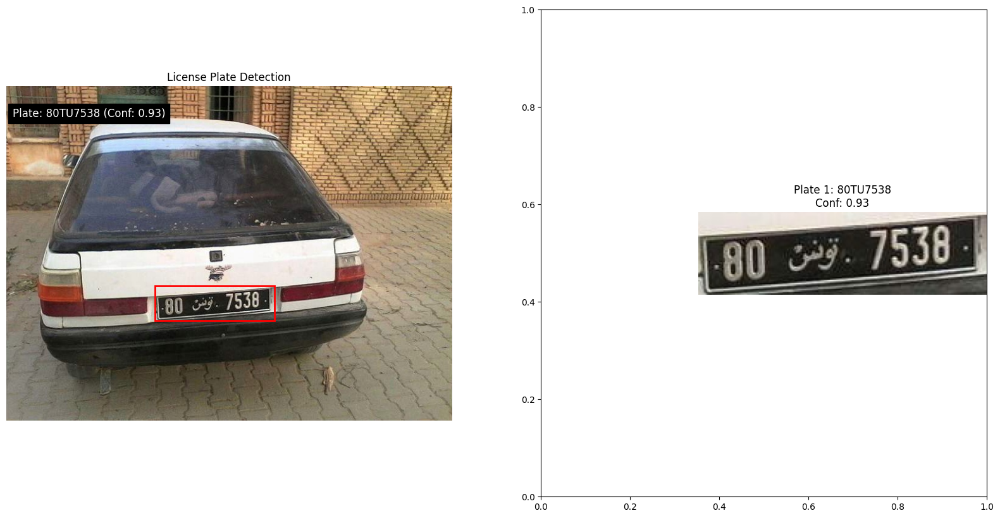


Processing image 8/20: 915.jpg

0: 384x640 1 license_plate, 10.1ms
Speed: 2.9ms preprocess, 10.1ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)

0: 128x416 1 0, 2 1s, 1 3, 2 4s, 1 TU, 11.0ms
Speed: 0.7ms preprocess, 11.0ms inference, 1.6ms postprocess per image at shape (1, 3, 128, 416)
Found 1 license plates:
- 131TU404 (Confidence: 0.92)
Processing time: 0.05 seconds


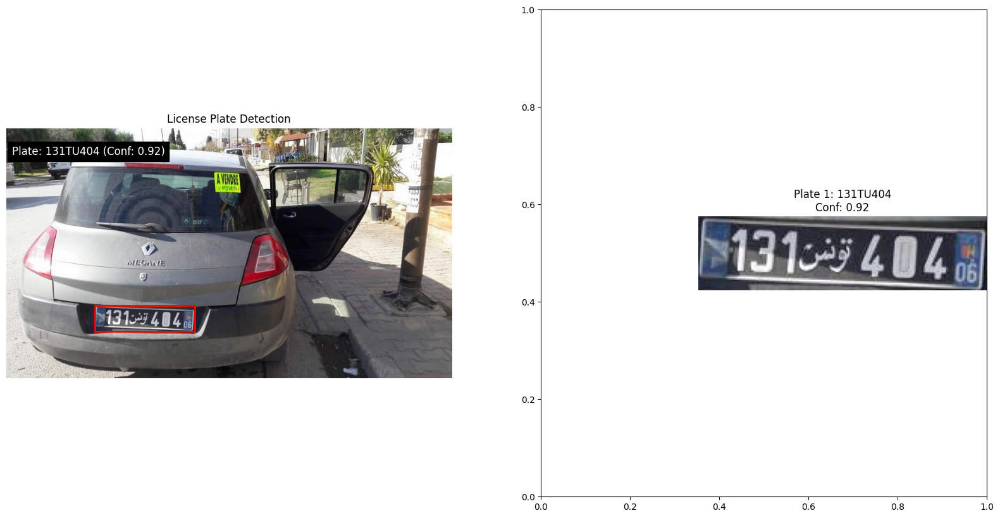


Processing image 9/20: 1073.jpg

0: 448x640 1 license_plate, 16.8ms
Speed: 3.3ms preprocess, 16.8ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)

0: 128x416 1 3, 1 4, 1 5, 1 7, 1 9, 1 TU, 9.1ms
Speed: 0.7ms preprocess, 9.1ms inference, 1.8ms postprocess per image at shape (1, 3, 128, 416)
Found 1 license plates:
- 94TU573 (Confidence: 0.89)
Processing time: 0.06 seconds


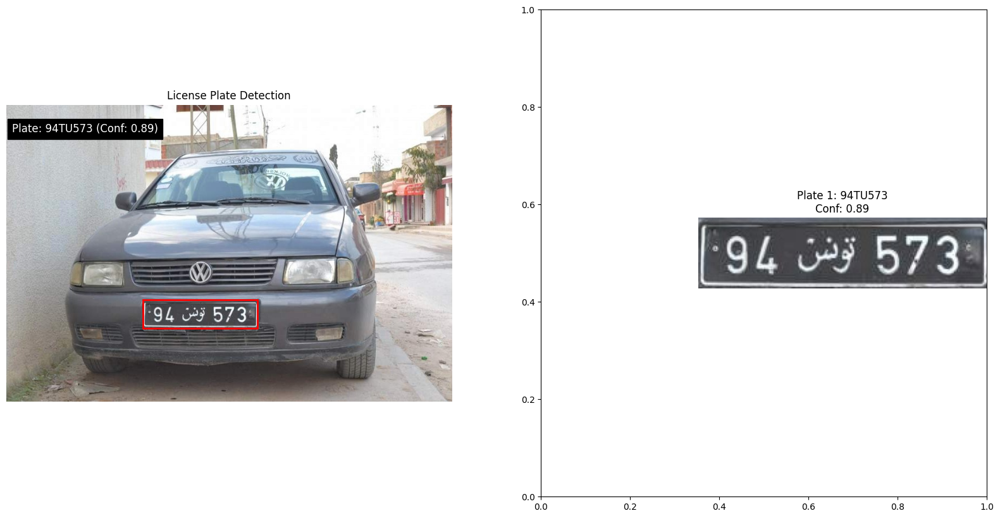


Processing image 10/20: 936.jpg

0: 384x640 1 license_plate, 9.5ms
Speed: 3.0ms preprocess, 9.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 128x416 1 0, 1 3, 1 4, 2 6s, 1 9, 1 TU, 8.3ms
Speed: 0.7ms preprocess, 8.3ms inference, 1.6ms postprocess per image at shape (1, 3, 128, 416)
Found 1 license plates:
- 90TU4636 (Confidence: 0.94)
Processing time: 0.04 seconds


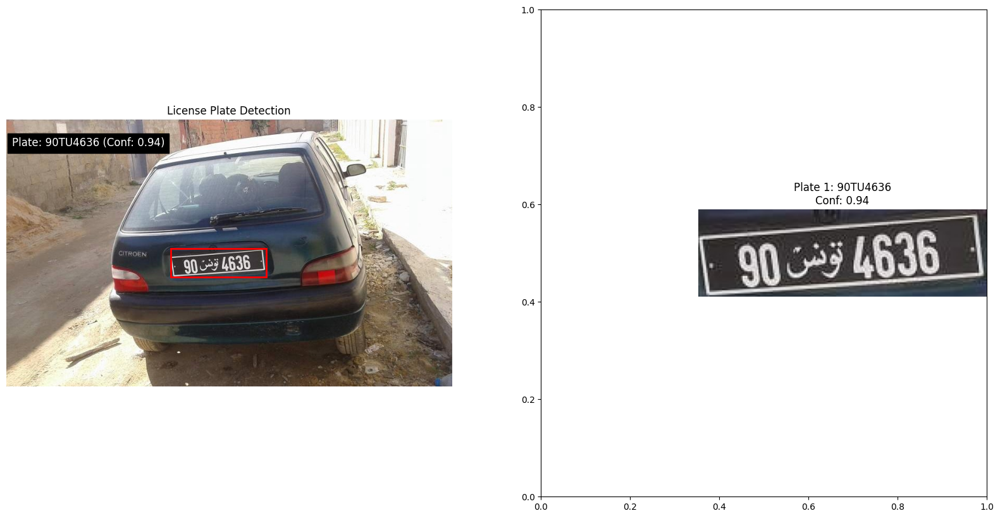


Processing image 11/20: 962.jpg

0: 384x640 1 license_plate, 11.9ms
Speed: 3.9ms preprocess, 11.9ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 640)

0: 96x416 1 1, 4 3s, 2 9s, 1 TU, 10.0ms
Speed: 3.3ms preprocess, 10.0ms inference, 1.4ms postprocess per image at shape (1, 3, 96, 416)
Found 1 license plates:
- 133TU9933 (Confidence: 0.93)
Processing time: 0.06 seconds


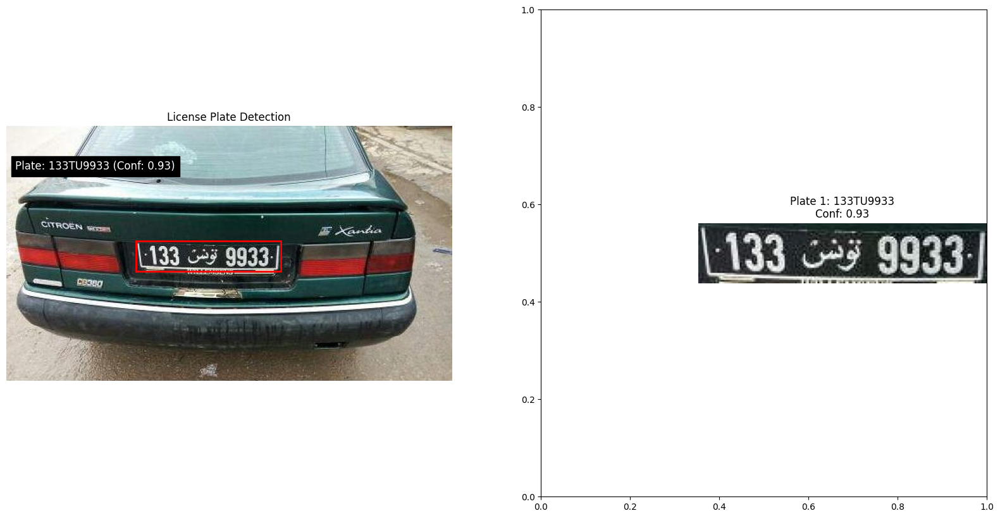


Processing image 12/20: 931.jpg

0: 480x640 1 license_plate, 10.9ms
Speed: 6.5ms preprocess, 10.9ms inference, 3.7ms postprocess per image at shape (1, 3, 480, 640)

0: 96x416 (no detections), 8.0ms
Speed: 0.8ms preprocess, 8.0ms inference, 0.6ms postprocess per image at shape (1, 3, 96, 416)
Found 1 license plates:
-  (Confidence: 0.00)
Processing time: 0.05 seconds


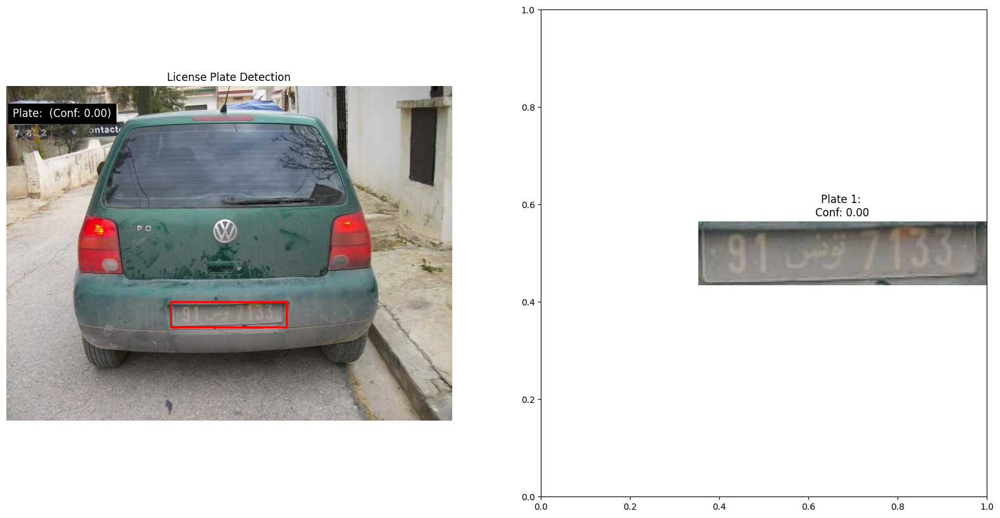


Processing image 13/20: 969.jpg

0: 640x480 1 license_plate, 21.2ms
Speed: 3.3ms preprocess, 21.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 480)

0: 224x416 3 1s, 1 5, 1 6, 1 7, 1 9, 1 TU, 80.2ms
Speed: 1.2ms preprocess, 80.2ms inference, 1.8ms postprocess per image at shape (1, 3, 224, 416)
Found 1 license plates:
- 165TU7119 (Confidence: 0.92)
Processing time: 0.13 seconds


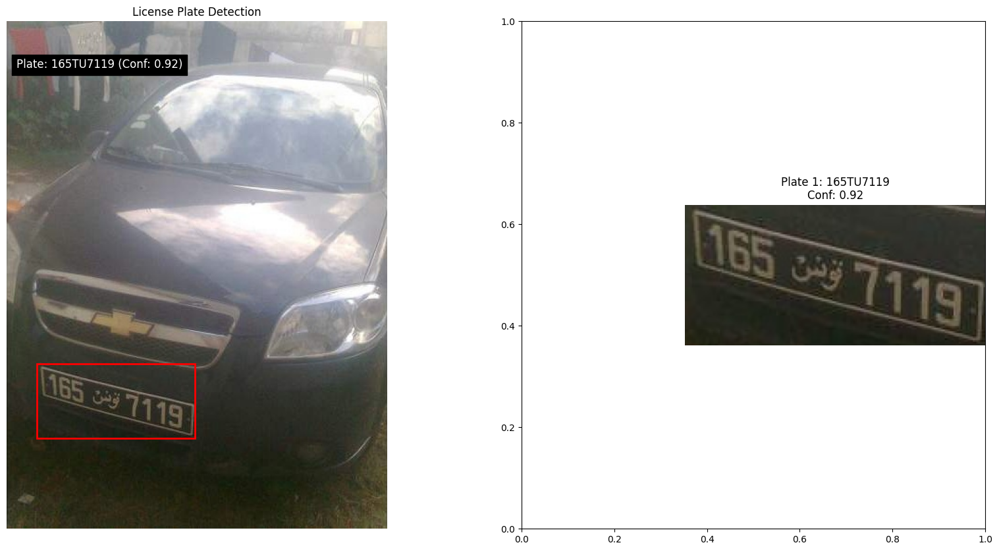


Processing image 14/20: 946.jpg

0: 480x640 1 license_plate, 12.9ms
Speed: 3.9ms preprocess, 12.9ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)

0: 128x416 1 0, 4 1s, 1 6, 1 7, 1 TU, 14.3ms
Speed: 0.7ms preprocess, 14.3ms inference, 1.4ms postprocess per image at shape (1, 3, 128, 416)
Found 1 license plates:
- 116TU1701 (Confidence: 0.92)
Processing time: 0.07 seconds


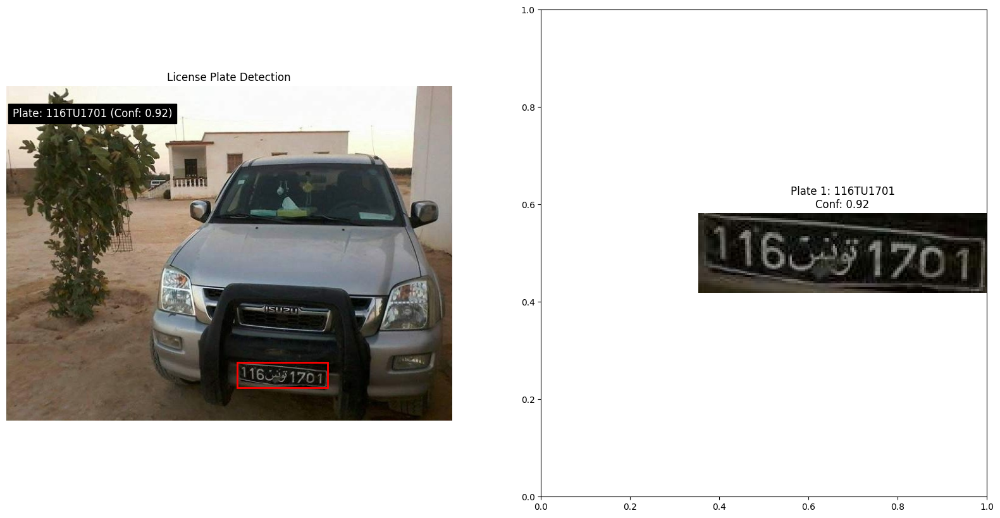


Processing image 15/20: 934.jpg

0: 384x640 1 license_plate, 10.9ms
Speed: 3.2ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 288x416 1 0, 1 1, 1 2, 1 3, 3 4s, 1 TU, 67.9ms
Speed: 1.2ms preprocess, 67.9ms inference, 3.1ms postprocess per image at shape (1, 3, 288, 416)
Found 1 license plates:
- 142TU4034 (Confidence: 0.92)
Processing time: 0.12 seconds


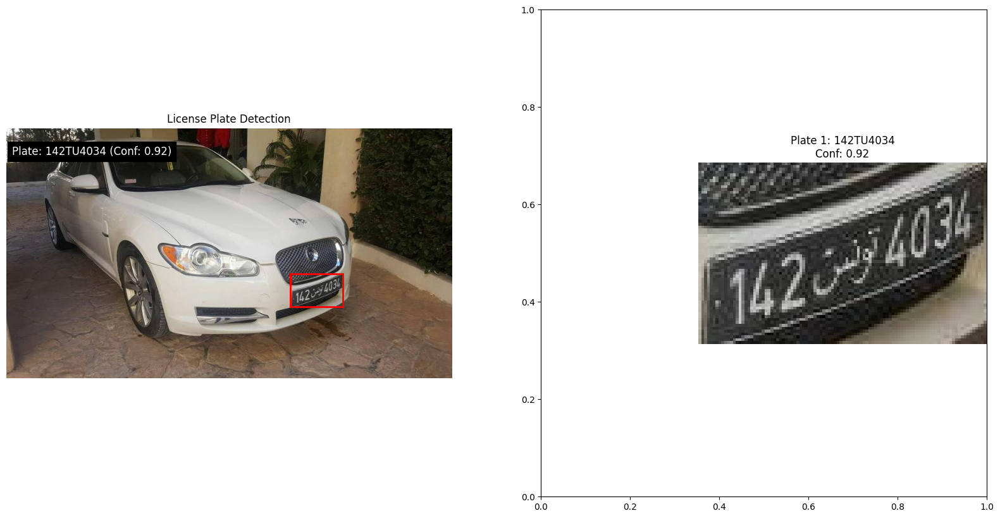


Processing image 16/20: 1086.jpg

0: 384x640 1 license_plate, 14.0ms
Speed: 3.2ms preprocess, 14.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 96x416 1 0, 1 2, 1 3, 1 4, 1 5, 1 7, 1 TU, 13.0ms
Speed: 0.7ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 96, 416)
Found 1 license plates:
- 72TU5043 (Confidence: 0.94)
Processing time: 0.07 seconds


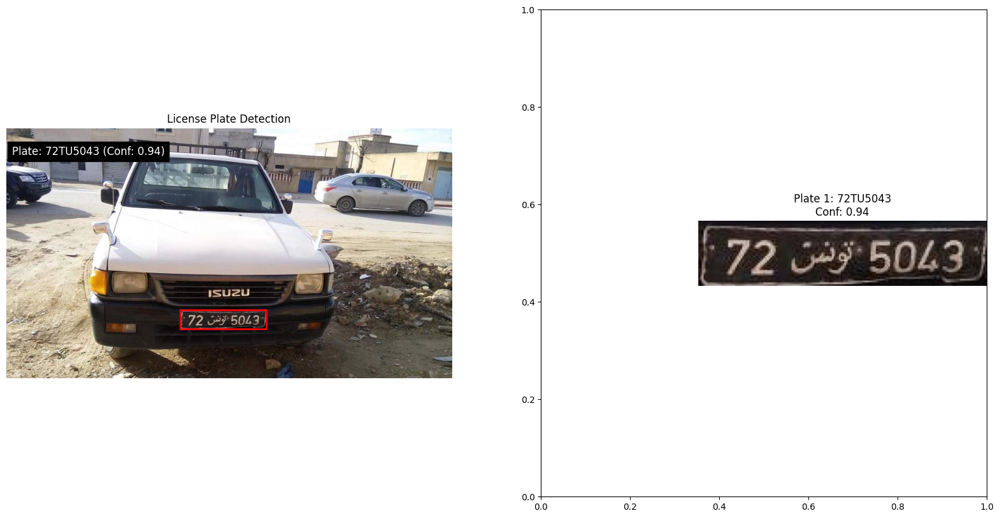


Processing image 17/20: 1102.jpg

0: 640x480 1 license_plate, 18.0ms
Speed: 3.4ms preprocess, 18.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 480)

0: 128x416 1 1, 2 4s, 1 5, 2 6s, 1 8, 1 TU, 14.0ms
Speed: 0.8ms preprocess, 14.0ms inference, 1.8ms postprocess per image at shape (1, 3, 128, 416)
Found 1 license plates:
- 164TU5864 (Confidence: 0.92)
Processing time: 0.07 seconds


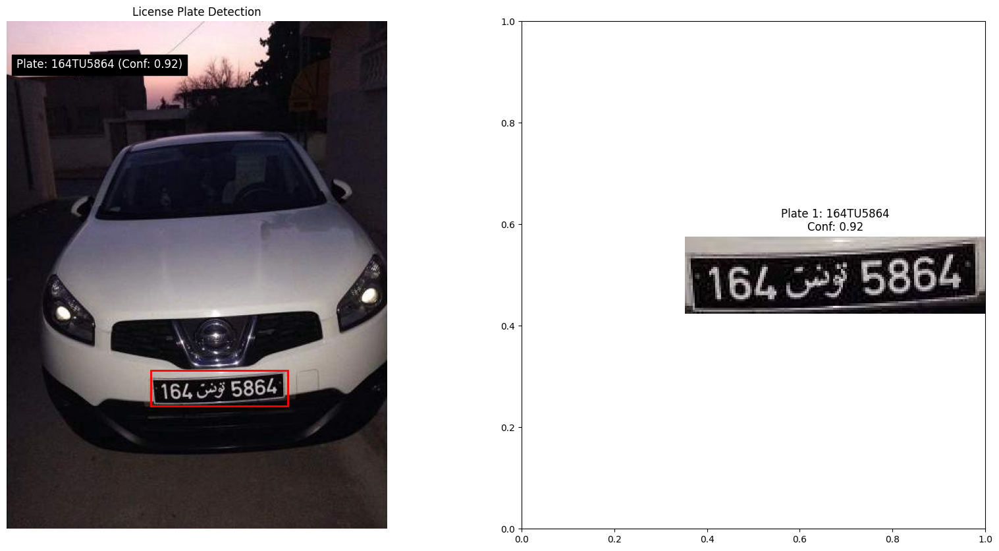


Processing image 18/20: 904.jpg

0: 384x640 1 license_plate, 10.0ms
Speed: 3.1ms preprocess, 10.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 96x416 1 1, 2 2s, 2 3s, 1 4, 1 6, 1 TU, 10.6ms
Speed: 0.6ms preprocess, 10.6ms inference, 1.3ms postprocess per image at shape (1, 3, 96, 416)
Found 1 license plates:
- 123TU6324 (Confidence: 0.90)
Processing time: 0.05 seconds


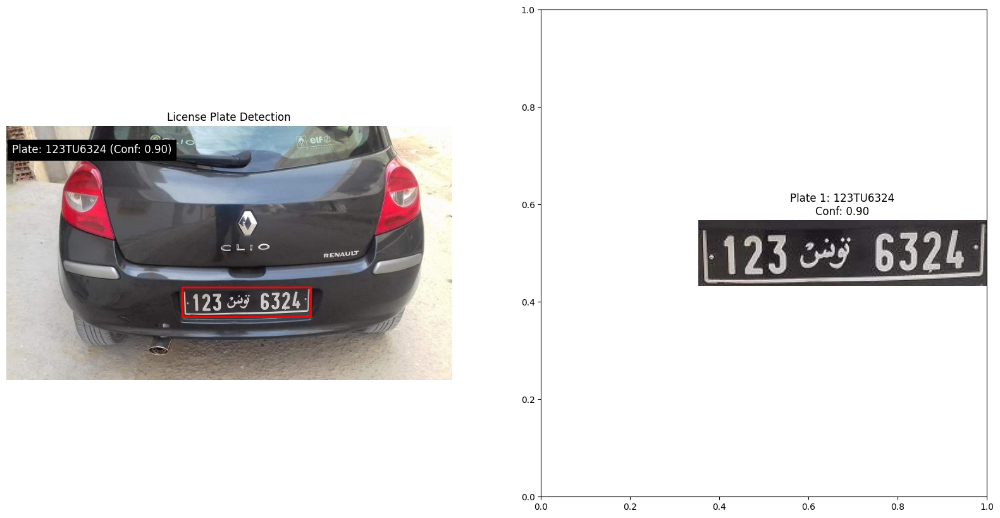


Processing image 19/20: 990.jpg

0: 640x480 1 license_plate, 11.9ms
Speed: 3.3ms preprocess, 11.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)

0: 160x416 1 1, 1 2, 3 3s, 2 5s, 1 TU, 62.4ms
Speed: 0.8ms preprocess, 62.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 416)
Found 1 license plates:
- 135TU5332 (Confidence: 0.94)
Processing time: 0.10 seconds


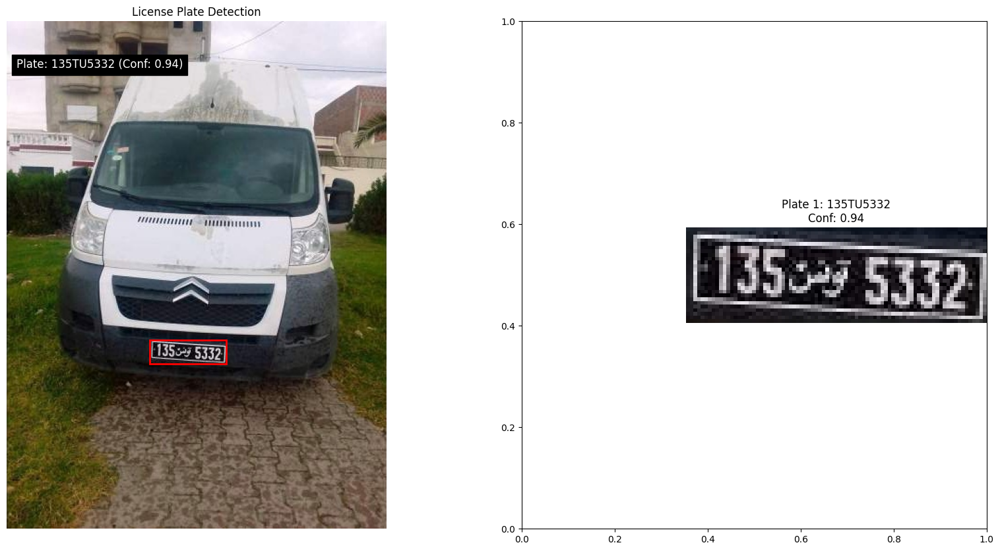


Processing image 20/20: 1085.jpg

0: 640x480 1 license_plate, 11.7ms
Speed: 3.4ms preprocess, 11.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)

0: 128x416 1 0, 1 1, 2 2s, 1 3, 1 6, 1 7, 1 TU, 9.8ms
Speed: 0.8ms preprocess, 9.8ms inference, 1.8ms postprocess per image at shape (1, 3, 128, 416)
Found 1 license plates:
- 172TU6302 (Confidence: 0.93)
Processing time: 0.05 seconds


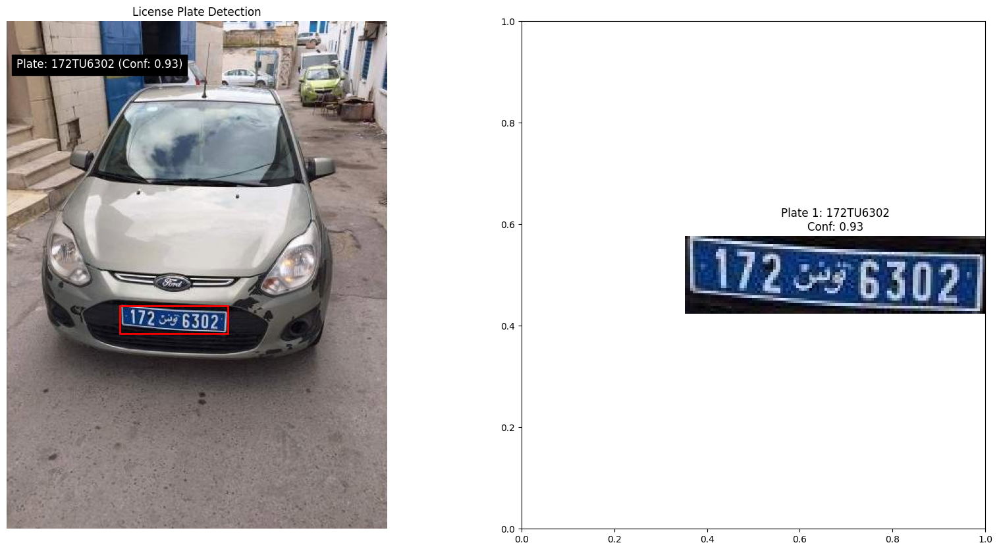


Processing Summary:
--------------------------------------------------
Total images processed: 20
Total plates detected: 20
Successful reads: 19
Average processing time: 0.07 seconds
Success rate: 95.0% (if plates were detected)


In [14]:
# Updated code with more comprehensive testing and visualization
import os
import cv2
import numpy as np
from ultralytics import YOLO
import matplotlib.pyplot as plt
from datetime import datetime

def process_image(image_path, plate_conf=0.5, char_conf=0.25):
    """Process a single image and return detected license plate numbers"""
    img = cv2.imread(image_path)
    if img is None:
        return "Error: Could not read image"

    # Store original image dimensions
    orig_h, orig_w = img.shape[:2]

    # Detect license plates
    plate_results = plate_detector(img, conf=plate_conf)[0]

    all_plates = []
    plate_regions = []  # Store plate regions for visualization

    # Process each detected license plate
    for plate_box in plate_results.boxes.data:
        if plate_box.is_cuda:
            plate_box = plate_box.cpu()
        plate_box = plate_box.numpy()

        x1, y1, x2, y2, conf, _ = plate_box
        if conf < plate_conf:
            continue

        # Store plate region coordinates
        plate_regions.append((int(x1), int(y1), int(x2), int(y2)))

        # Crop license plate
        plate_img = img[int(y1):int(y2), int(x1):int(x2)]

        # Detect characters in the plate
        char_results = char_detector(plate_img, conf=char_conf)[0]

        boxes = []
        texts = []
        scores = []

        for char_box in char_results.boxes.data:
            if char_box.is_cuda:
                char_box = char_box.cpu()
            char_box = char_box.numpy()

            x1, y1, x2, y2, conf, cls = char_box
            if conf < char_conf:
                continue
            boxes.append([x1, y1, x2, y2])
            texts.append(char_detector.names[int(cls)])
            scores.append(conf)

        # Sort characters left to right
        sorted_texts, sorted_scores = sort_boxes_left_to_right(boxes, texts, scores)

        # Combine characters into plate number
        plate_number = ''.join(sorted_texts)
        avg_confidence = np.mean(sorted_scores) if sorted_scores else 0

        all_plates.append((plate_number, avg_confidence, plate_img))

    return all_plates, plate_regions, img

def visualize_results(image_path, results, plate_regions, original_img):
    """Enhanced visualization of the detection results"""
    plt.figure(figsize=(20, 10))

    # Plot original image with detections
    plt.subplot(1, 2, 1)
    img_rgb = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)

    # Draw rectangles around plate regions
    for (x1, y1, x2, y2) in plate_regions:
        plt.gca().add_patch(plt.Rectangle((x1, y1), x2-x1, y2-y1,
                                        fill=False, color='red', linewidth=2))

    # Add text with results
    y_pos = 50
    for plate_number, confidence, _ in results:
        plt.text(10, y_pos, f"Plate: {plate_number} (Conf: {confidence:.2f})",
                color='white', backgroundcolor='black', fontsize=12)
        y_pos += 30

    plt.title("License Plate Detection")
    plt.axis('off')

    # Plot individual plate crops
    plt.subplot(1, 2, 2)
    if results:
        n_plates = len(results)
        for idx, (plate_number, conf, plate_img) in enumerate(results):
            plt.subplot(1, 2+n_plates, 3+idx)
            plt.imshow(cv2.cvtColor(plate_img, cv2.COLOR_BGR2RGB))
            plt.title(f"Plate {idx+1}: {plate_number}\nConf: {conf:.2f}")
            plt.axis('off')

    plt.tight_layout()
    plt.show()

def process_directory(test_dir, max_images=10):
    """Process multiple images with enhanced reporting"""
    image_extensions = {'.jpg', '.jpeg', '.png', '.bmp'}

    # Get list of image files
    image_files = [f for f in os.listdir(test_dir)
                  if os.path.splitext(f.lower())[1] in image_extensions]

    # Statistics
    total_plates = 0
    successful_reads = 0
    processing_times = []

    print(f"Found {len(image_files)} images. Processing up to {max_images}...")

    # Process images
    for idx, img_file in enumerate(image_files[:max_images]):
        img_path = os.path.join(test_dir, img_file)
        print(f"\nProcessing image {idx+1}/{min(max_images, len(image_files))}: {img_file}")

        try:
            start_time = datetime.now()

            # Process image
            results, plate_regions, original_img = process_image(img_path)

            # Calculate processing time
            processing_time = (datetime.now() - start_time).total_seconds()
            processing_times.append(processing_time)

            # Update statistics
            total_plates += len(results)
            successful_reads += len([r for r in results if r[0]])  # Count non-empty readings

            # Print results
            print(f"Found {len(results)} license plates:")
            for plate_number, confidence, _ in results:
                print(f"- {plate_number} (Confidence: {confidence:.2f})")
            print(f"Processing time: {processing_time:.2f} seconds")

            # Visualize results
            visualize_results(img_path, results, plate_regions, original_img)

        except Exception as e:
            print(f"Error processing {img_file}: {str(e)}")

    # Print summary statistics
    print("\nProcessing Summary:")
    print("-" * 50)
    print(f"Total images processed: {min(max_images, len(image_files))}")
    print(f"Total plates detected: {total_plates}")
    print(f"Successful reads: {successful_reads}")
    print(f"Average processing time: {np.mean(processing_times):.2f} seconds")
    print(f"Success rate: {(successful_reads/total_plates)*100:.1f}% (if plates were detected)")

# Test the pipeline with more images
TEST_DIR = '/content/drive/MyDrive/testing_cars/test/test_private'
process_directory(TEST_DIR, max_images=20)  # Process up to 20 images